In [35]:
import librosa

import os
import shutil
import yaml

from IPython.display import Audio

The folder structure of Scaper should look like this.

    - foreground
        - siren
            - siren1.wav
            - siren2.wav
            - some_siren_sound.wav
        - car_honk
            - honk.wav
            - beep.wav
        - human_voice
            - hello_world.wav
            - shouting.wav
    - background
        - park
            - central_park.wav
        - street
            - quiet_street.wav
            - loud_street.wav

In [52]:
output_base_dir = '/mnt/storage_1/datasets/bioacoustic_sed/sources/'
train_dir = 'train_sources'
test_dir = 'test_sources'
bg_dir = 'background'

In [65]:
# TUT rare sounds 2017
tut_base_dir = '/mnt/storage_1/datasets/TUT_rare_sed_2017/TUT-rare-sound-events-2017-development/data/source_data/'
tut_bg_dir   = 'bgs'
tut_event_dir = 'events'
tut_splits_dir = 'cv_setup'

bgs_devtest_yaml     = 'bgs_devtest.yaml'
bgs_devtrain_yaml    = 'bgs_devtrain.yaml'
events_devtest_yaml  = 'events_devtest.yaml'
events_devtrain_yaml = 'events_devtrain.yaml'

splits = [bgs_devtest_yaml, bgs_devtrain_yaml]
for split in splits:
    if 'train' in split:
        output_source_dir = train_dir
    else:
        output_source_dir = test_dir
        
    with open(os.path.join(tut_base_dir, tut_splits_dir, split), 'r') as f:
        meta_data = yaml.safe_load(f)

    for m in meta_data:
        class_name     = m['classname']
        class_name     = "_".join(class_name.split('/'))
        tut_audio_path = m['filepath']

        move_to_dir  = os.path.join(output_base_dir, output_source_dir, bg_dir, class_name)
        move_to_path = os.path.join(move_to_dir, os.path.basename(tut_audio_path))

        if not os.path.exists(move_to_dir):
            os.makedirs(move_to_dir)

        # move the audio to the correct directory
        move_from_path = os.path.join(tut_base_dir, tut_bg_dir, tut_audio_path)
        shutil.copyfile(move_from_path, move_to_path)
    

# 1. extract background classes
# 2. copy into respective train_source / test_source



In [59]:
with open(os.path.join(tut_base_dir, tut_splits_dir, bgs_devtest_yaml), 'r') as file:
    content = yaml.safe_load(file)
#print(content)
set([c['classname'] for c in content])
#with open(os.path.join(tut_base_dir, tut_splits_dir, events_devtrain_yaml), 'r') as file:
#    content = yaml.safe_load(file)
#print(content['babycry'][0]['audio_filename'])

{'beach',
 'bus',
 'cafe/restaurant',
 'car',
 'city_center',
 'forest_path',
 'grocery_store',
 'home',
 'library',
 'metro_station',
 'office',
 'park',
 'residential_area',
 'train',
 'tram'}

In [41]:
class_name = 'babycry'
wav_path = os.path.join(tut_base_dir, tut_event_dir, class_name, content[class_name][0]['audio_filename'])
#wav_path = os.path.join(tut_base_dir, tut_bg_dir, class_name
wave, sr = librosa.load(wav_path)
print(len(wave) / sr)

82.49242630385487


In [42]:
# DCASE few-shot bioacoustic event detection

In [46]:
 content[class_name][1]

{'audio_filename': '243989.wav',
 'id': 243989,
 'parent_meta': {'avg_rating': 0.0,
  'channels': 2,
  'description': 'Poikavauva, 2 kk, itkee, parkuu huoneessa.\r\n\r\nÄänitetty / Rec: Analoginen nauha, Nagra / Analog tape, Nagra\r\n\r\nPaikka/Place: Suomi / Finland / Helsinki\r\nAika/Date: 1978',
  'duration': 82.4924,
  'filesize': 24835834,
  'license': 'http://creativecommons.org/licenses/by/3.0/',
  'name': 'Vauva, lapsi, itkee, parkuu / A babyboy, two months of age, crying',
  'num_ratings': 0,
  'samplerate': 48000,
  'url': 'https://www.freesound.org/people/YleArkisto/sounds/243989/',
  'username': 'YleArkisto'},
 'segment': [5.9799999999999995, 8.72]}

In [43]:
Audio(wav_path)

In [83]:
from scipy.signal.windows import gaussian
import matplotlib.pyplot as plt
import numpy as np

1.0


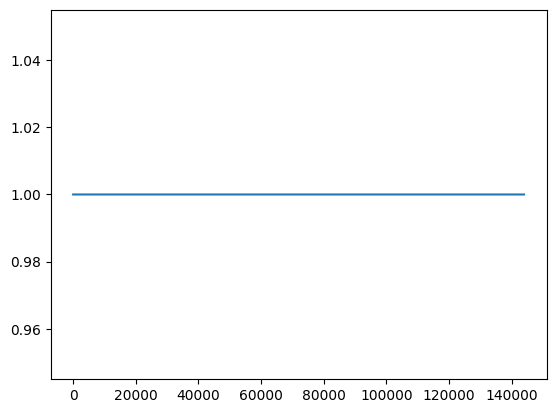

In [96]:
n_samples = 144000
sr        = 48000
duration  = n_samples / sr

dt  = 100000000000000000000000000000000000000000000 # seconds
std = sr * dt / 6 
window = gaussian(n_samples, std=std)
print(np.max(window))


#print(std * 6)

# 6 stds cover 99.7 % of signal energy
plt.plot(window)

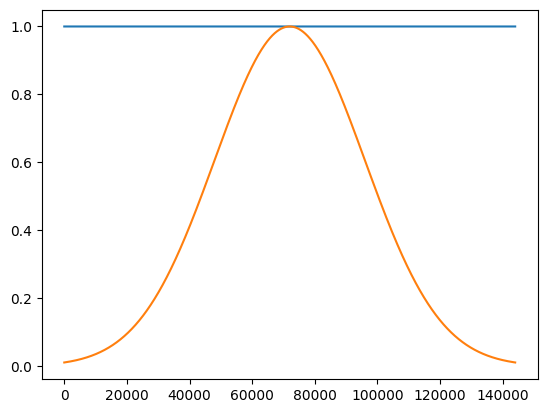

In [89]:
data = np.ones((16, 144000))
plt.plot(data[0])
data = data * window
plt.plot(data[1])

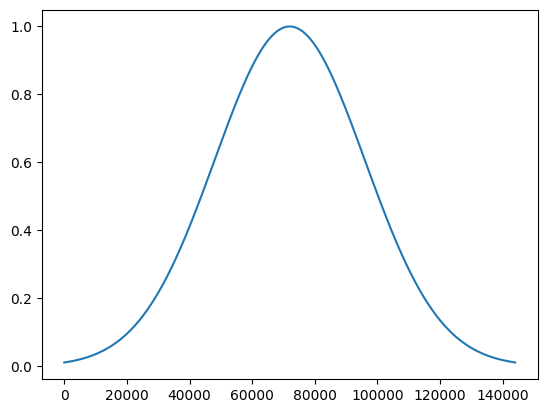

In [88]:
plt.plot(data[6])